# 1. Introduction

Final project, AI-based recommendation system for digital assets

#2. Import libraries

In [1]:
# import packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import glob
from pathlib import Path
import statistics
from sklearn import metrics
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import layers
from keras.utils.vis_utils import plot_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten, Input, Conv2D, MaxPooling2D, GlobalAveragePooling2D, LSTM
from PIL import Image
import pickle
import warnings
warnings.filterwarnings('ignore')

#3. Data loading

In [2]:
# import dataset from Kaggle to Colab

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle

!mkdir ./kaggle
!mv ./kaggle.json ./kaggle

!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d kaushiksuresh147/metaverse-cryptos-historical-data

!mkdir ./data

if os.path.exists('data/Metaverse coins/') == False :
  !unzip -d ./data ./metaverse-cryptos-historical-data.zip 

  0% 0.00/4.24M [00:00<?, ?B/s]
100% 4.24M/4.24M [00:00<00:00, 103MB/s]
Archive:  ./metaverse-cryptos-historical-data.zip
  inflating: ./data/Metaverse coins/1BOX.csv  
  inflating: ./data/Metaverse coins/7Pixels.csv  
  inflating: ./data/Metaverse coins/9D NFT.csv  
  inflating: ./data/Metaverse coins/AFKDAO.csv  
  inflating: ./data/Metaverse coins/ALI Token.csv  
  inflating: ./data/Metaverse coins/ARize.csv  
  inflating: ./data/Metaverse coins/ASIX Token.csv  
  inflating: ./data/Metaverse coins/ASSAPLAY.csv  
  inflating: ./data/Metaverse coins/Aavegotchi.csv  
  inflating: ./data/Metaverse coins/AcknoLedger.csv  
  inflating: ./data/Metaverse coins/AdShares.csv  
  inflating: ./data/Metaverse coins/Adroverse.csv  
  inflating: ./data/Metaverse coins/Affyn.csv  
  inflating: ./data/Metaverse coins/Age Of Knights.csv  
  inflating: ./data/Metaverse coins/Alien Inu.csv  
  inflating: ./data/Metaverse coins/Altura.csv  
  inflating: ./data/Metaverse coins/American Shiba.csv  
  infl

In [3]:
# get token names

file_list = sorted(os.listdir('./data/Metaverse coins/'))

token_names = []

for i in range(len(file_list)):
  token_names.append(file_list[i].partition('.csv')[0])

token_names.remove('Battle Inu')
token_names.remove('Metaverse coins')
token_names.remove('Lelouch Lamperouge')

In [4]:
# create dataframe

df = {}
for i in token_names:
  df[i] = pd.read_csv("./data/Metaverse coins/" + i + ".csv", index_col="Date", parse_dates=["Date"])
  df[i].drop(['Currency'], axis=1)

# 4. EDA

In [5]:
# filter coins

filtered_names = []

for i in token_names:
  if len(df[i]) >= 365 * 3:
    filtered_names.append(i)

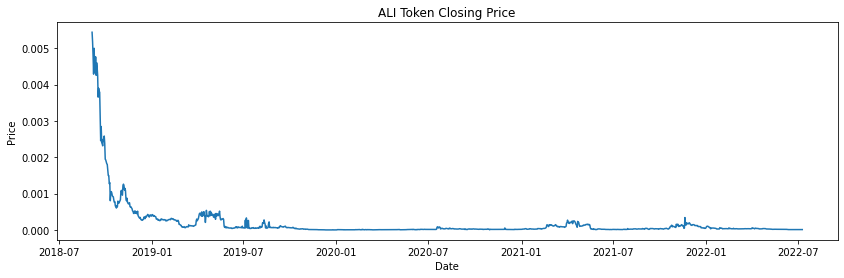

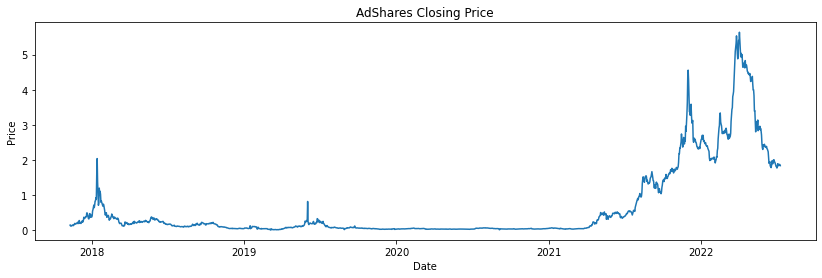

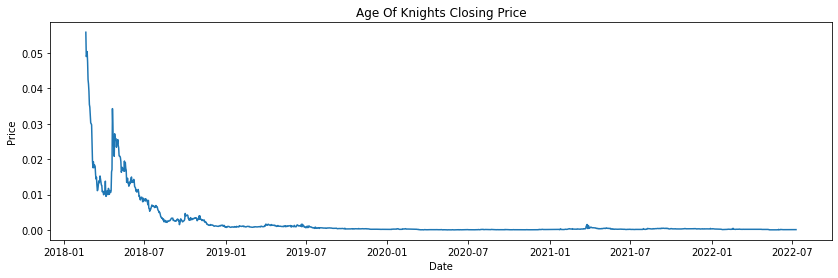

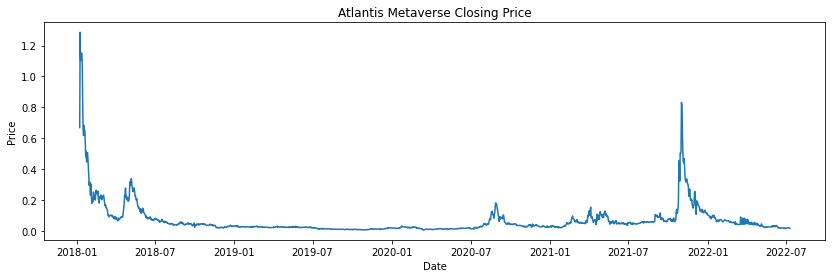

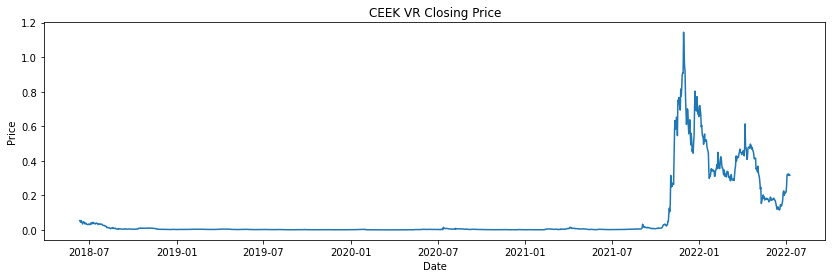

...

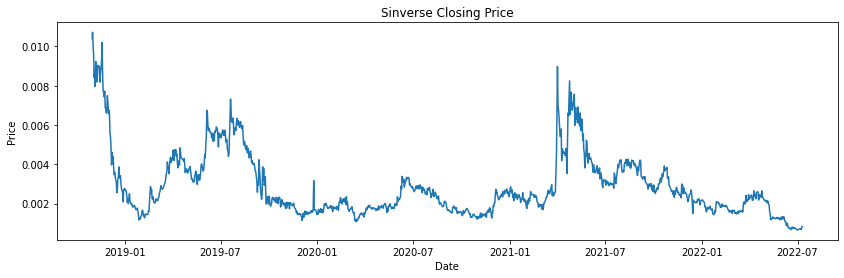

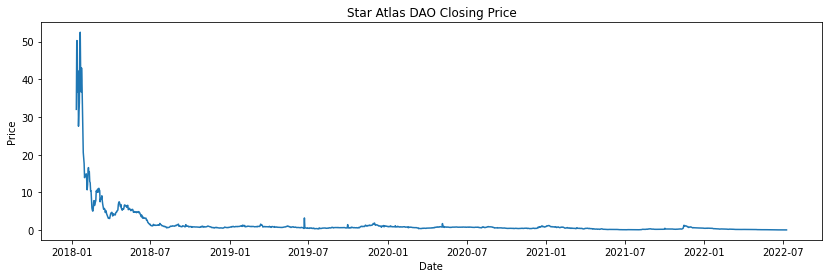

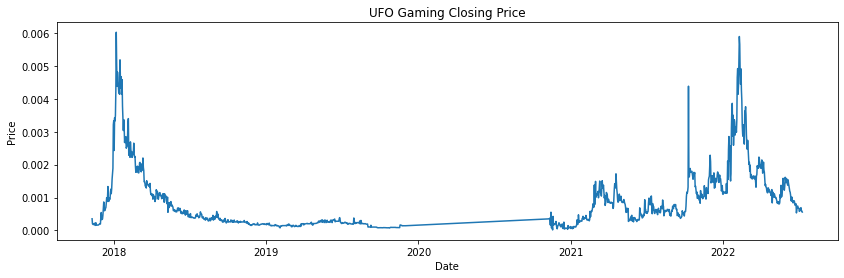

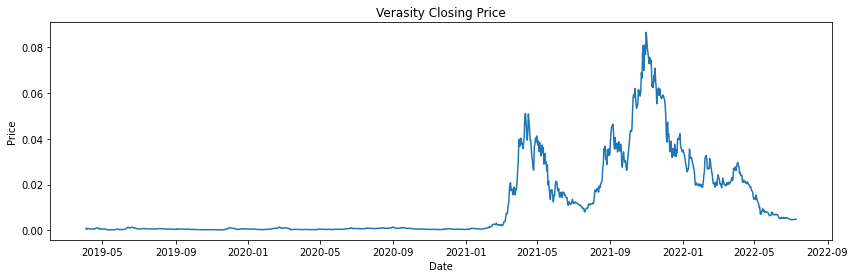

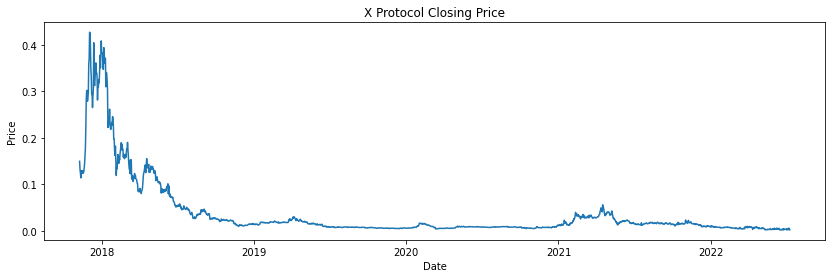

In [6]:
# visualize data

for i in filtered_names:
#for i in token_names:
  plt.figure(figsize=(14,4))
  plt.plot(df[i]['Close'])
  plt.ylabel("Price")
  plt.xlabel("Date")
  plt.title(i + " Closing Price")

#5. Data preprocessing

In [7]:
# calculate standard deviation

std = []

#for i in filtered_names:
for i in token_names:
  std.append(statistics.stdev(df[i]['Close']))

In [8]:
# group tokens based on risk

low = []
medium = []
high = []

group_range = max(std) - min(std)
group = group_range/3

#for i, j in enumerate(filtered_names):
for i, j in enumerate(token_names):
  if std[i] >= min(std) and std[i] < min(std) + group:
    low.append(j)
  elif std[i] >= min(std) + group and std[i] < 2 * group:
    medium.append(j)
  else:
    high.append(j)

In [9]:
# filter out the last 100 days

#for i in filtered_names:
#  df[i] = df[i][:-100]

In [10]:
# calculate growth

growths = []

#for i in filtered_names:
for i in token_names:
  growth = (df[i]['Close'].iloc[-1] - df[i]['Close'].iloc[0])/df[i]['Close'].iloc[0]
  growths.append(growth)

In [11]:
# split train and test data

df_new = {}
#for i in filtered_names:
for i in token_names:
  df_new[i] = {}
  training_size = int(len(df[i])*0.65)
  test_size = len(df[i]) - training_size
  df_new[i]["Train"] = df[i][0:training_size] 
  df_new[i]["Test"] = df[i][training_size:len(df[i])]

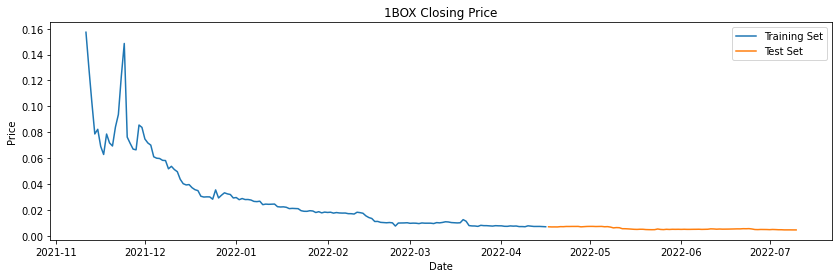

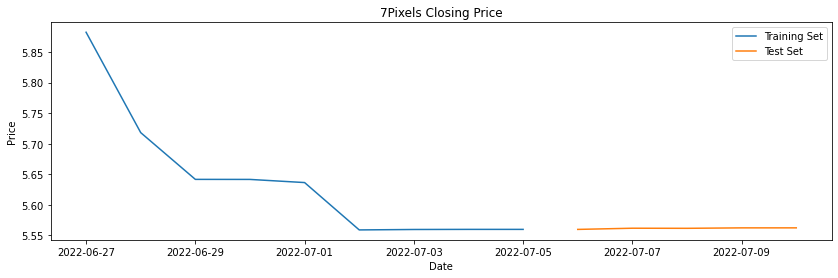

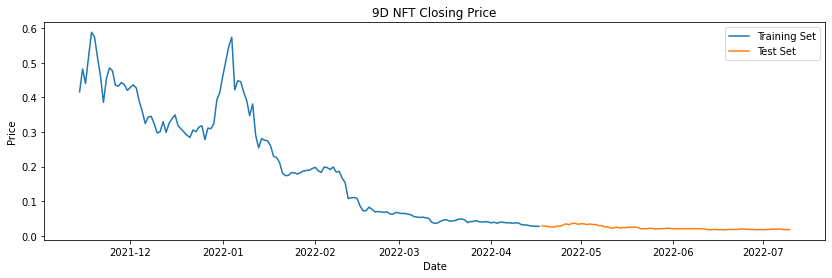

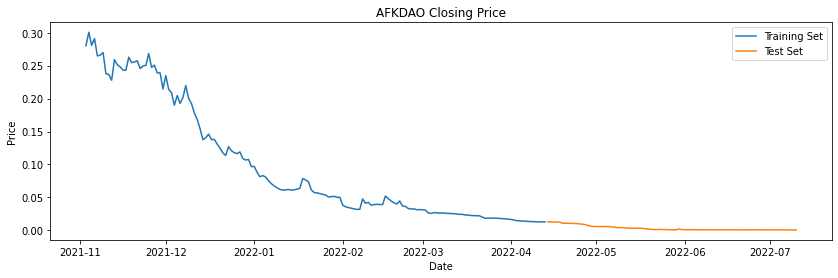

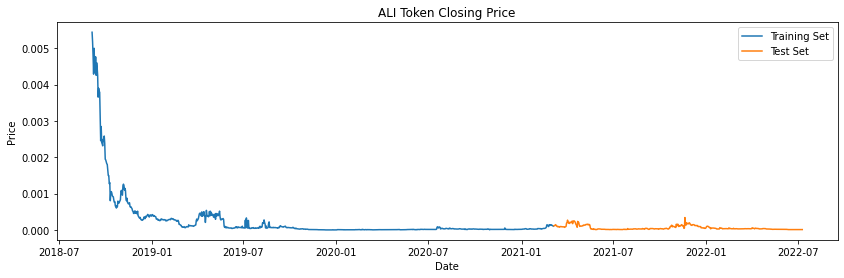

...

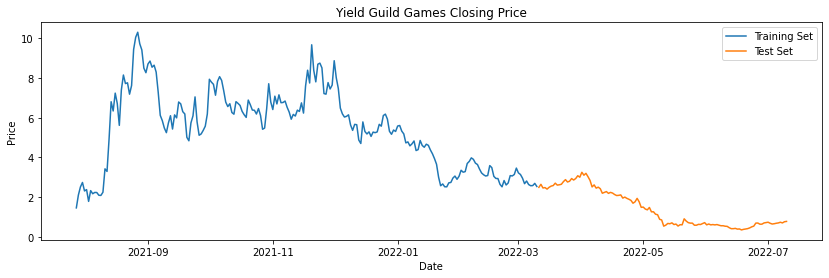

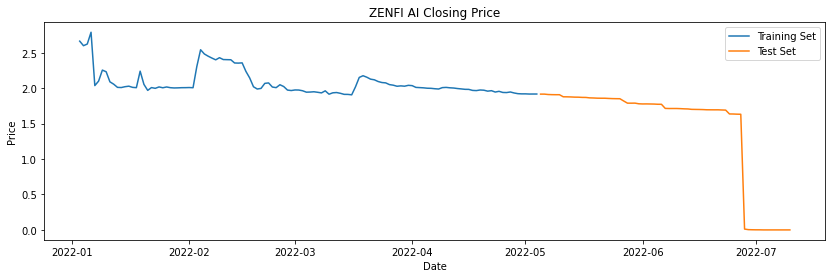

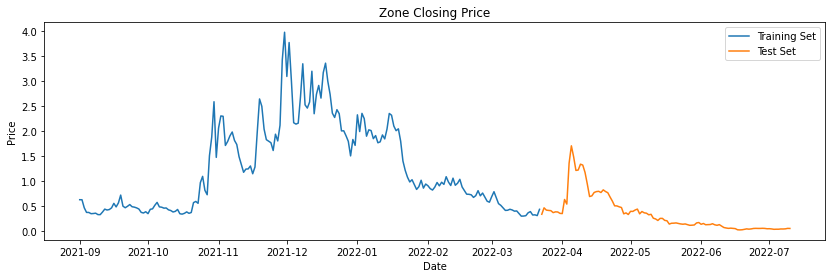

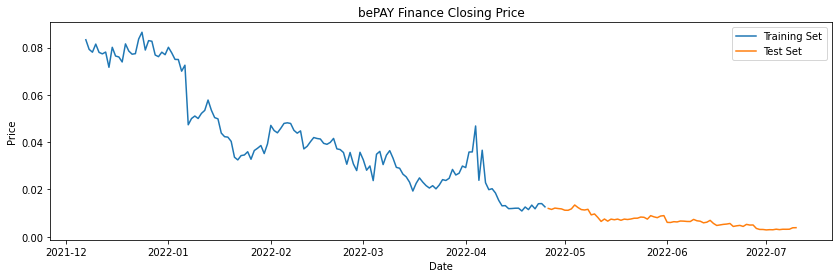

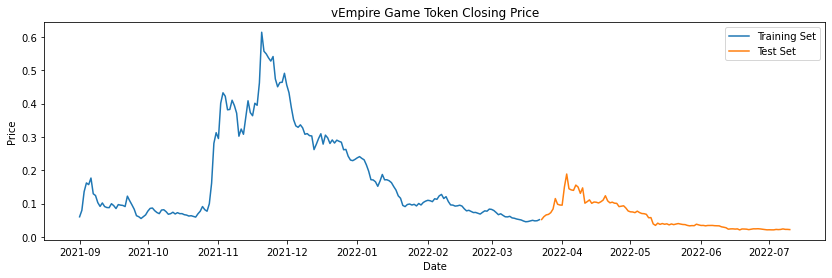

In [12]:
# visualize train and test data

#for i in filtered_names:
for i in token_names:
  plt.figure(figsize=(14,4))
  plt.plot(df_new[i]["Train"]['Close'])
  plt.plot(df_new[i]["Test"]['Close'])
  plt.ylabel("Price")
  plt.xlabel("Date")
  plt.legend(["Training Set", "Test Set"])
  plt.title(i + " Closing Price")

In [13]:
# scale data

transform_train = {}
transform_test = {}
scaler = {}

#for num, i in enumerate(filtered_names):
for num, i in enumerate(token_names):
  sc = MinMaxScaler(feature_range=(0,1))
  a0 = np.array(df_new[i]["Train"]['Close'])
  a1 = np.array(df_new[i]["Test"]['Close'])
  a0 = a0.reshape(a0.shape[0],1)
  a1 = a1.reshape(a1.shape[0],1)
  transform_train[i] = sc.fit_transform(a0)
  transform_test[i] = sc.fit_transform(a1)
  scaler[i] = sc

In [23]:
# split X and y

trainset = {}
testset = {}
#for j in filtered_names:
for j in token_names:
  time_step = len(transform_train[j])//2
  #time_step = 7
  trainset[j] = {}
  X_train = []
  y_train = []
  for i in range(len(transform_train[j]) - time_step - 1):
    X_train.append(transform_train[j][i:(i + time_step), 0])
    y_train.append(transform_train[j][i + time_step, 0])
    X_train
  X_train, y_train = np.array(X_train), np.array(y_train)
  trainset[j]["X"] = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
  trainset[j]["y"] = y_train
    
  time_step = len(transform_test[j])//2
  testset[j] = {}
  X_test = []
  y_test = []    
  for i in range(len(transform_test[j]) - time_step -  1):
    X_test.append(transform_test[j][i:(i + time_step), 0])
    y_test.append(transform_test[j][i + time_step, 0])
  X_test, y_test = np.array(X_test), np.array(y_test)
  testset[j]["X"] = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
  testset[j]["y"] = y_test

In [24]:
# summarize shapes

arr_buff = []

#for i in filtered_names:
for i in token_names:
  buff = {}
  buff["X_train"] = trainset[i]["X"].shape
  buff["y_train"] = trainset[i]["y"].shape
  buff["X_test"] = testset[i]["X"].shape
  buff["y_test"] = testset[i]["y"].shape
  arr_buff.append(buff)

#pd.DataFrame(arr_buff, index=filtered_names)
pd.DataFrame(arr_buff, index=token_names)

,X_train,y_train,X_test,y_test
1BOX,"(78, 78, 1)","(78,)","(42, 42, 1)","(42,)"
7Pixels,"(4, 4, 1)","(4,)","(2, 2, 1)","(2,)"
9D NFT,"(77, 77, 1)","(77,)","(41, 42, 1)","(41,)"
AFKDAO,"(80, 81, 1)","(80,)","(43, 44, 1)","(43,)"
ALI Token,"(456, 456, 1)","(456,)","(245, 246, 1)","(245,)"
...,...,...,...,...
Yield Guild Games,"(112, 113, 1)","(112,)","(60, 61, 1)","(60,)"
ZENFI AI,"(60, 61, 1)","(60,)","(33, 33, 1)","(33,)"
Zone,"(100, 101, 1)","(100,)","(54, 55, 1)","(54,)"
bePAY Finance,"(69, 70, 1)","(69,)","(37, 38, 1)","(37,)"


#6. Model definition

In [25]:
# define architecture

regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=True, input_shape=(None,1)))
regressor.add(Dropout(0.2))
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.2))
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.5))
regressor.add(LSTM(units=50))
regressor.add(Dropout(0.5))
regressor.add(Dense(units=1))

In [26]:
# compile model

regressor.compile(optimizer='rmsprop', loss='mean_squared_error')

#7. Model training

In [27]:
# train model

#for i in filtered_names:
for i in token_names:
  print("Fitting to", i)
  regressor.fit(trainset[i]["X"], trainset[i]["y"], epochs=10, batch_size=32)

Streaming output truncated to the last 5000 lines.
3/3 [==============================] - 0s 16ms/step - loss: 3.8377e-04
Fitting to Elvantis
Epoch 1/10
4/4 [==============================] - 0s 19ms/step - loss: 0.0336
Epoch 2/10
4/4 [==============================] - 0s 20ms/step - loss: 0.0252
Epoch 3/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0323
Epoch 4/10
4/4 [==============================] - 0s 18ms/step - loss: 0.0249
Epoch 5/10
4/4 [==============================] - 0s 20ms/step - loss: 0.0244
Epoch 6/10
4/4 [==============================] - 0s 20ms/step - loss: 0.0268
Epoch 7/10
4/4 [==============================] - 0s 20ms/step - loss: 0.0258
Epoch 8/10
4/4 [==============================] - 0s 22ms/step - loss: 0.0264
Epoch 9/10
4/4 [==============================] - 0s 18ms/step - loss: 0.0259
Epoch 10/10
4/4 [==============================] - 0s 21ms/step - loss: 0.0265
Fitting to Endless Battlefield
Epoch 1/10
2/2 [==============================

#8. Model evaluation

### Make prediction and visualize performance

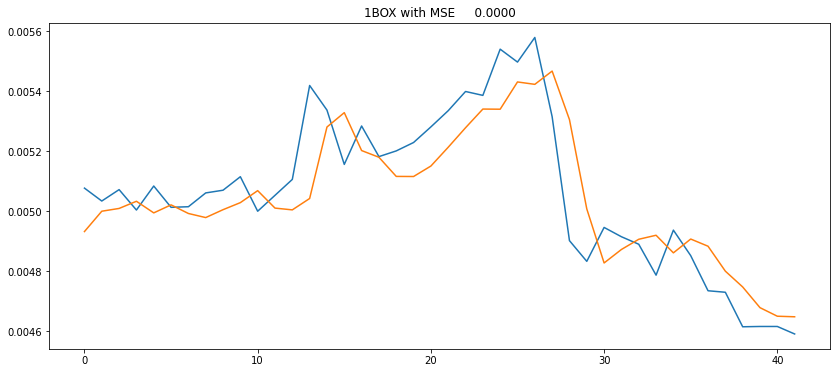

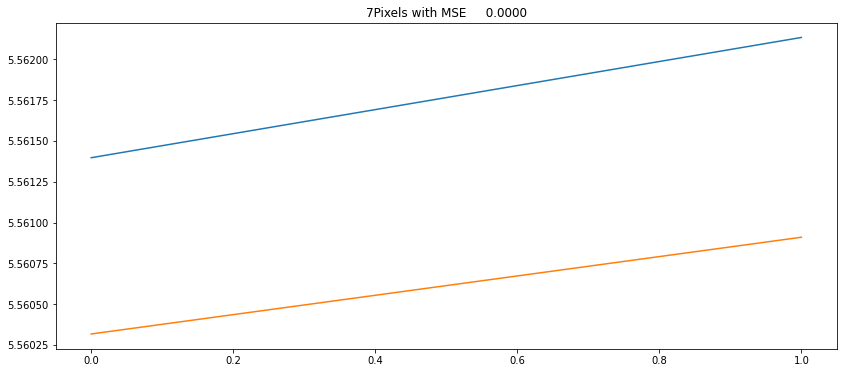

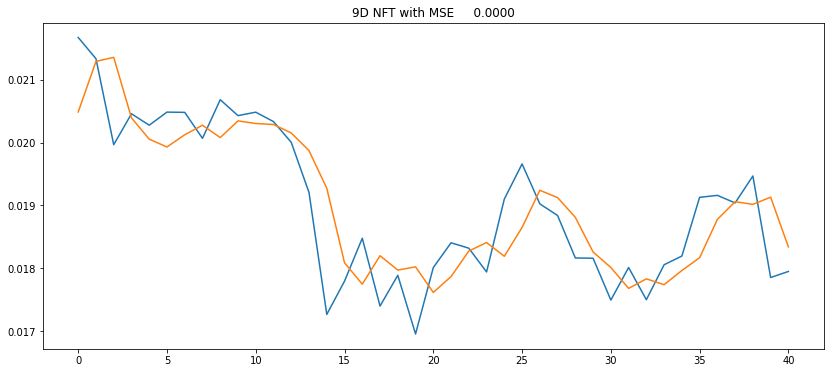

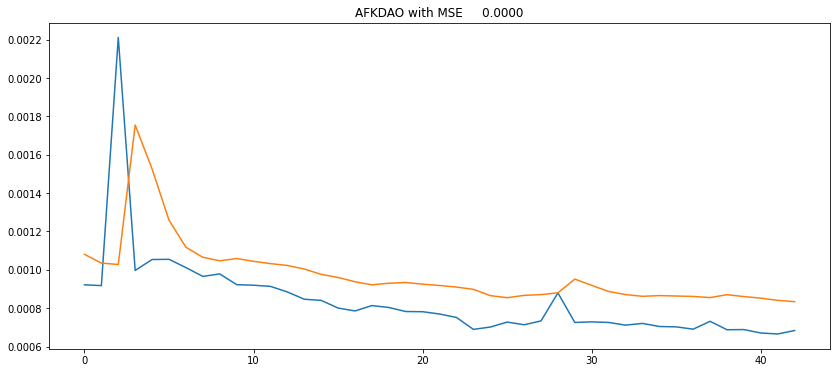

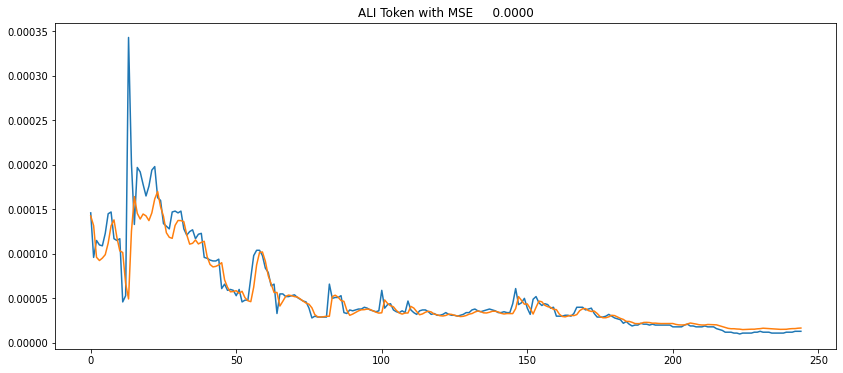

...

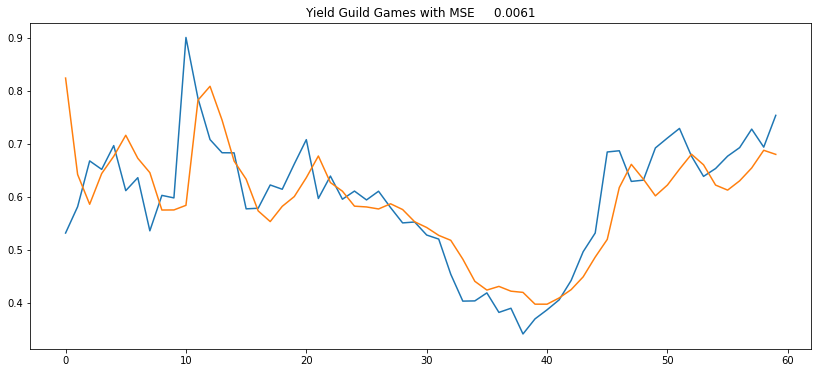

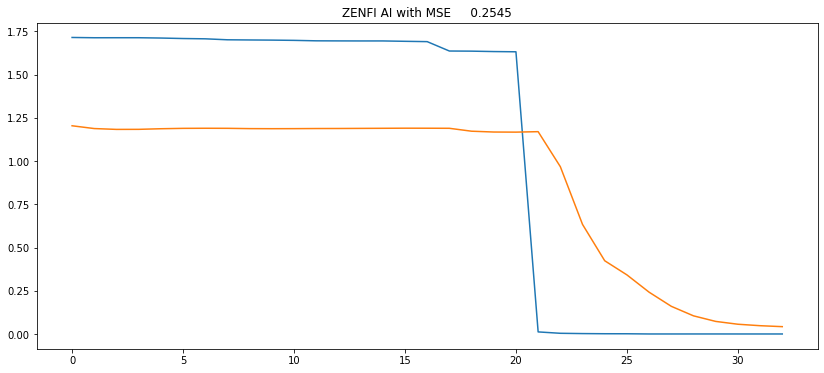

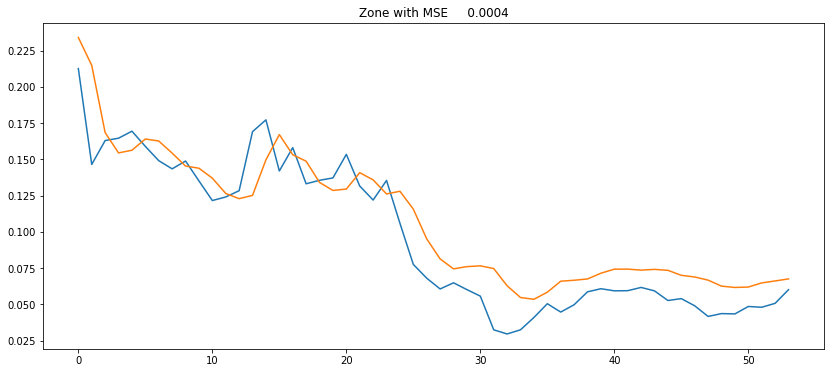

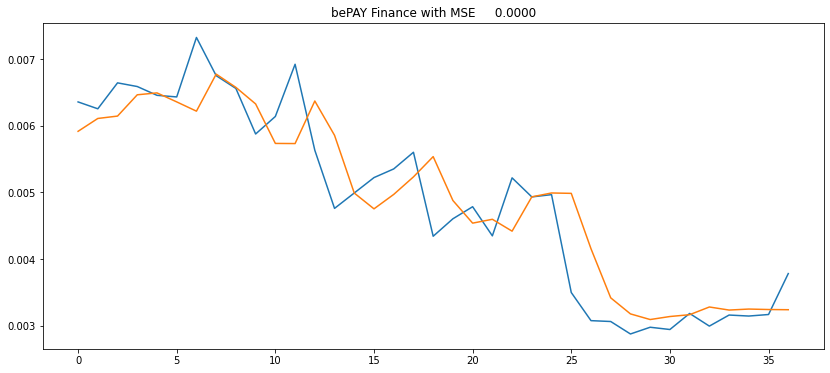

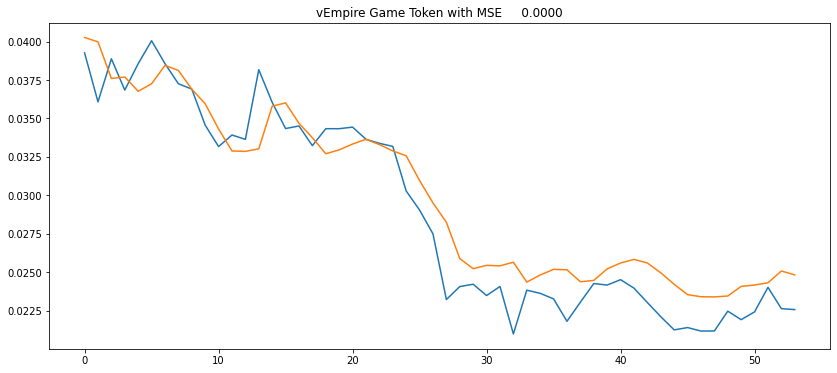

In [28]:
# make predictions

#for i in filtered_names:
for i in token_names:
  y_true = scaler[i].inverse_transform(testset[i]["y"].reshape(-1,1))
  y_pred = scaler[i].inverse_transform(regressor.predict(testset[i]["X"]))
  MSE = mean_squared_error(y_true, y_pred)
  
  plt.figure(figsize=(14,6))
  plt.title("{} with MSE {:10.4f}".format(i,MSE))
  plt.plot(y_true)
  plt.plot(y_pred)

### Multi-step LSTM

In [29]:
# define function for multi-step prediction

def long_predict(name, days):
  y_future = []

  x_pred = testset[name]['X'][-1:, :, :]
  y_pred = testset[name]["y"][-1]

  for i in range(days):
    x_pred = np.append(x_pred[:, 1:, :], y_pred.reshape(1, 1, 1), axis=1)
    y_pred = regressor.predict(x_pred)
    y_future.append(y_pred.flatten()[0])

  y_future = np.array(y_future).reshape(-1, 1)
  y_future = scaler[name].inverse_transform(y_future)

  df_past = df[name][['Close']].reset_index()
  df_past.rename(columns={'index': 'Date'}, inplace=True)
  df_past['Date'] = pd.to_datetime(df_past['Date'])
  df_past['Forecast'] = np.nan

  df_future = pd.DataFrame(columns=['Date', 'Close', 'Forecast'])
  df_future['Date'] = pd.date_range(start=df_past['Date'].iloc[-1] + pd.Timedelta(days=1), periods=days)
  df_future['Forecast'] = y_future.flatten()
  df_future['Close'] = np.nan

  results = df_past.append(df_future).set_index('Date')

  plt.figure(figsize=(14,6))
  plt.title(name)
  plt.plot(results)

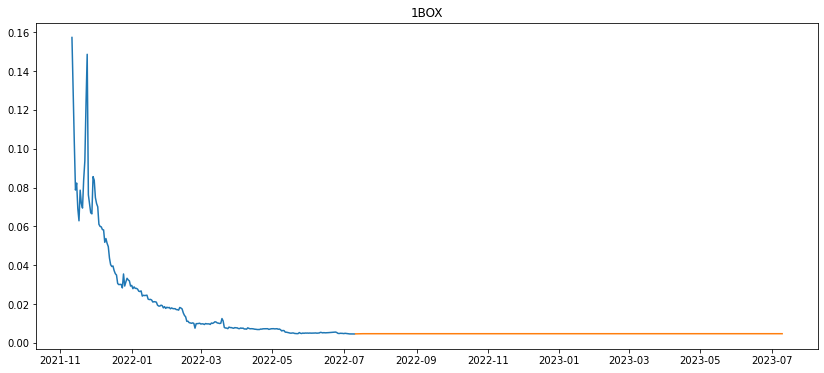

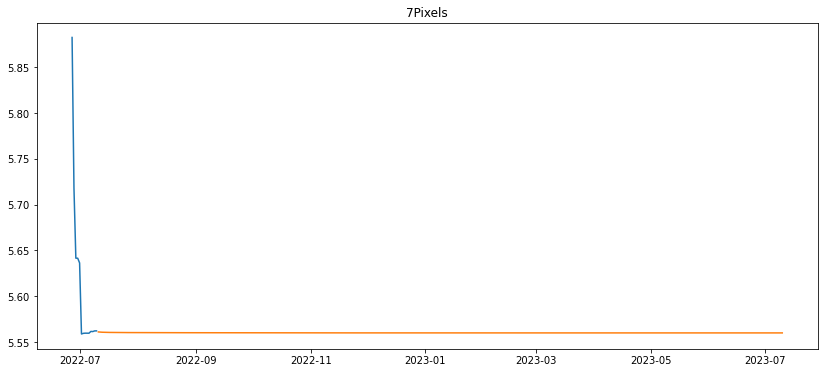

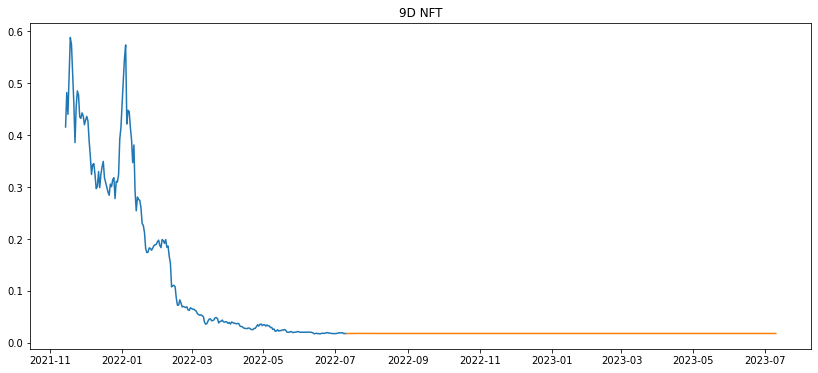

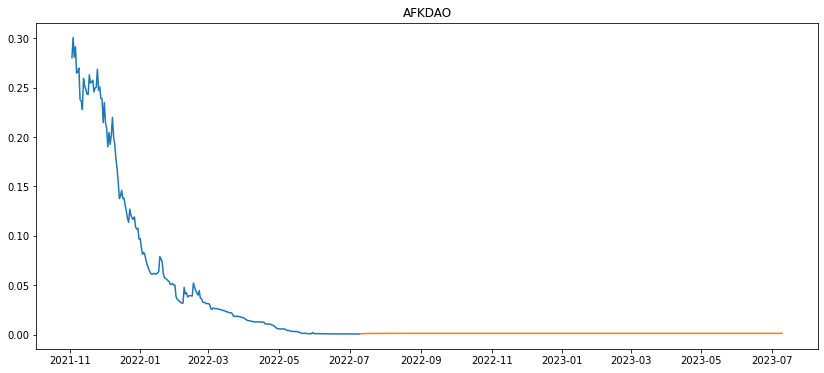

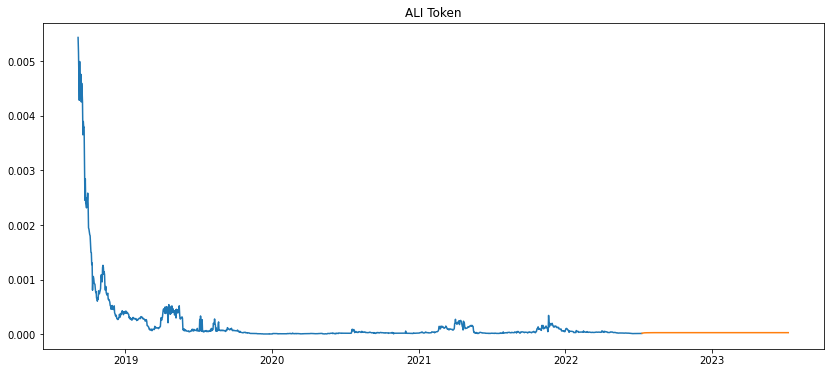

...

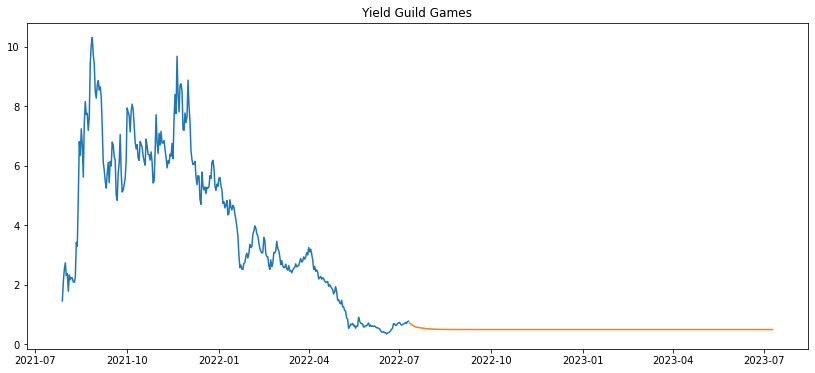

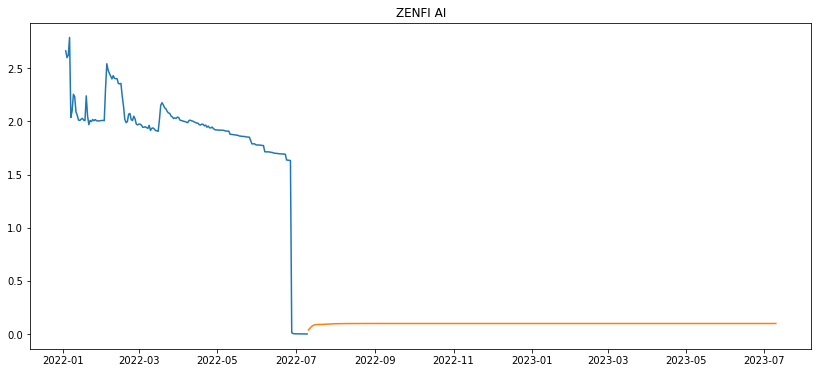

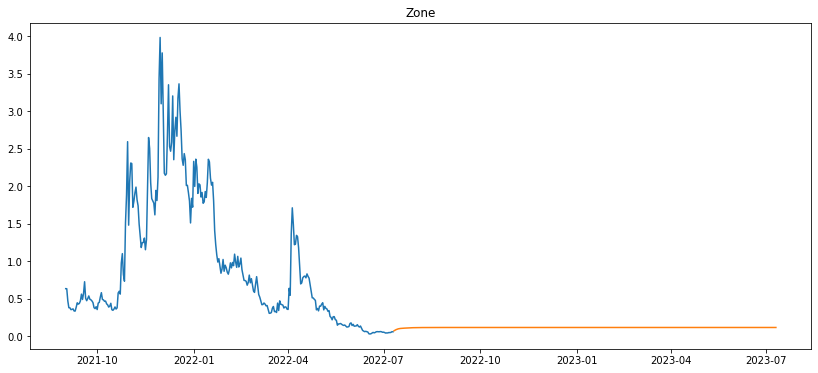

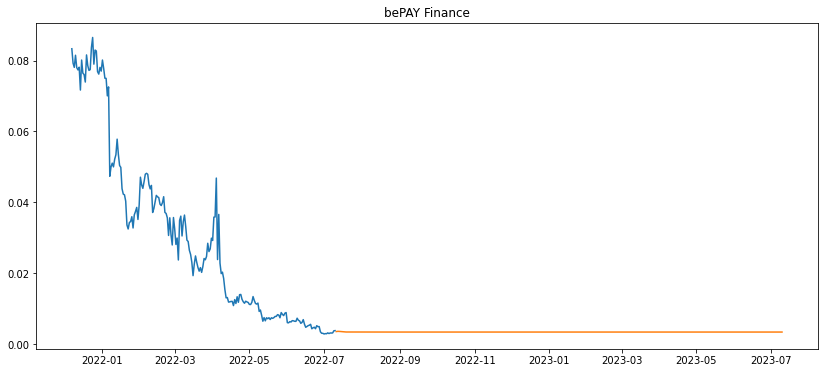

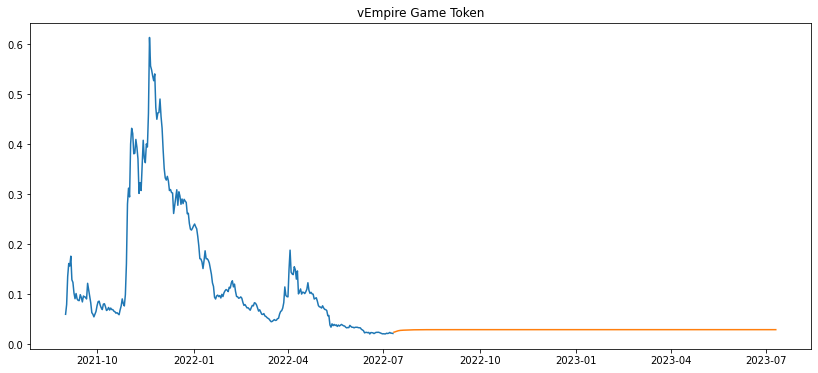

In [31]:
# make multi-step predictions

#for i in filtered_names:
for i in token_names:
  long_predict(i, 365)

#9. Model saving

In [32]:
with open("regressor.pkl", "wb") as model_file:
  pickle.dump(regressor, model_file)